In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import Normalize
import matplotlib.cm as cm
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px
import plotly.figure_factory as ff
import time

In [2]:
node_metrics = pd.read_csv("data/node_metrics.csv", index_col=[0])
node_metrics

,cellid,mitoid,count,diams,nodedist,nodeid
0,648518346349539333,2718056,21,0.655340,26594.530396,17670
1,648518346349539333,2718056,38,0.929892,26869.960938,17708
2,648518346349539333,2718056,22,0.853151,27009.407959,17725
3,648518346349539333,2718056,24,0.748397,26464.676453,17653
4,648518346349539333,2718056,18,0.585603,25934.409683,17576
...,...,...,...,...,...,...
3684332,648518346349538298,1911448,21,1.085070,4941.646362,8327
3684333,648518346349538298,1911448,7,1.143378,4779.511353,8324
3684334,648518346349538298,1911448,12,2.120830,10383.978722,8333
3684335,648518346349538298,1911448,20,1.705424,8208.868919,8526


In [3]:
# make cellid_str and mitoid_str columns for plotly purposes

node_metrics['cellid_str'] = node_metrics['cellid'].astype(str)
node_metrics['mitoid_str'] = node_metrics['mitoid'].astype(str)
node_metrics

,cellid,mitoid,count,diams,nodedist,nodeid,cellid_str,mitoid_str
0,648518346349539333,2718056,21,0.655340,26594.530396,17670,648518346349539333,2718056
1,648518346349539333,2718056,38,0.929892,26869.960938,17708,648518346349539333,2718056
2,648518346349539333,2718056,22,0.853151,27009.407959,17725,648518346349539333,2718056
3,648518346349539333,2718056,24,0.748397,26464.676453,17653,648518346349539333,2718056
4,648518346349539333,2718056,18,0.585603,25934.409683,17576,648518346349539333,2718056
...,...,...,...,...,...,...,...,...
3684332,648518346349538298,1911448,21,1.085070,4941.646362,8327,648518346349538298,1911448
3684333,648518346349538298,1911448,7,1.143378,4779.511353,8324,648518346349538298,1911448
3684334,648518346349538298,1911448,12,2.120830,10383.978722,8333,648518346349538298,1911448
3684335,648518346349538298,1911448,20,1.705424,8208.868919,8526,648518346349538298,1911448


In [4]:
# pull in sa, complexity and compartment so I can color by compartment

mito = pd.read_csv('data/pni_mito_cellswskel_v185_fullstats.csv')
mito

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,surface_area,complexityindex,compartment
0,1783325,527936,75186,43844,1430,74824,43668,1323,75472,44120,1561,648518346349523993,300744,175376,57200,6.187842,20.482515,Basal
1,3272360,354680,101562,47000,241,101260,46750,191,101750,47228,303,648518346349538711,406248,188000,9640,3.780227,10.346855,Apical
2,1776789,523452,74500,43210,1457,73444,42632,1401,75636,43732,1564,648518346349538102,298000,172840,58280,6.992364,30.063988,Apical
3,2158922,4428,81214,54992,1230,81172,54962,1228,81254,55018,1235,648518346349538730,324856,219968,49200,0.129240,2.652803,Apical
4,2158896,11196,81194,53124,2007,81142,53096,2004,81250,53168,2014,648518346349532295,324776,212496,80280,0.224896,2.186498,Axonal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
210970,1302900,2116324,65836,40492,311,65132,40146,191,66430,40734,368,648518346349516055,263344,161968,12440,20.038195,43.285222,Unknown
210971,3189781,2193980,98800,58132,469,98240,57710,379,99286,58468,536,648518346349539215,395200,232528,18760,21.290737,48.309769,Unknown
210972,2657020,2453896,88816,68882,429,88220,68540,21,89432,69438,877,648518346349539376,355264,275528,17160,25.841965,69.054582,Basal
210973,1307970,2617596,66122,41208,293,65406,40902,173,66600,41576,356,648518346349516055,264488,164832,11720,27.147893,70.360888,Unknown


In [5]:
mito_merge = mito[['mito_id','surface_area', 'complexityindex', 'compartment']]
mito_merge

,mito_id,surface_area,complexityindex,compartment
0,1783325,6.187842,20.482515,Basal
1,3272360,3.780227,10.346855,Apical
2,1776789,6.992364,30.063988,Apical
3,2158922,0.129240,2.652803,Apical
4,2158896,0.224896,2.186498,Axonal
...,...,...,...,...
210970,1302900,20.038195,43.285222,Unknown
210971,3189781,21.290737,48.309769,Unknown
210972,2657020,25.841965,69.054582,Basal
210973,1307970,27.147893,70.360888,Unknown


In [6]:
node_metrics_merge = pd.merge(node_metrics, mito_merge, left_on='mitoid', right_on='mito_id', how='inner')
node_metrics_merge.drop(columns='mito_id', inplace=True)
node_metrics_merge

,cellid,mitoid,count,diams,nodedist,nodeid,cellid_str,mitoid_str,surface_area,complexityindex,compartment
0,648518346349539333,2718056,21,0.655340,26594.530396,17670,648518346349539333,2718056,6.903265,21.396764,Basal
1,648518346349539333,2718056,38,0.929892,26869.960938,17708,648518346349539333,2718056,6.903265,21.396764,Basal
2,648518346349539333,2718056,22,0.853151,27009.407959,17725,648518346349539333,2718056,6.903265,21.396764,Basal
3,648518346349539333,2718056,24,0.748397,26464.676453,17653,648518346349539333,2718056,6.903265,21.396764,Basal
4,648518346349539333,2718056,18,0.585603,25934.409683,17576,648518346349539333,2718056,6.903265,21.396764,Basal
...,...,...,...,...,...,...,...,...,...,...,...
3684332,648518346349538298,1911448,21,1.085070,4941.646362,8327,648518346349538298,1911448,5.679162,7.871268,Basal
3684333,648518346349538298,1911448,7,1.143378,4779.511353,8324,648518346349538298,1911448,5.679162,7.871268,Basal
3684334,648518346349538298,1911448,12,2.120830,10383.978722,8333,648518346349538298,1911448,5.679162,7.871268,Basal
3684335,648518346349538298,1911448,20,1.705424,8208.868919,8526,648518346349538298,1911448,5.679162,7.871268,Basal


In [7]:
node_metrics_merge

,cellid,mitoid,count,diams,nodedist,nodeid,cellid_str,mitoid_str,surface_area,complexityindex,compartment
0,648518346349539333,2718056,21,0.655340,26594.530396,17670,648518346349539333,2718056,6.903265,21.396764,Basal
1,648518346349539333,2718056,38,0.929892,26869.960938,17708,648518346349539333,2718056,6.903265,21.396764,Basal
2,648518346349539333,2718056,22,0.853151,27009.407959,17725,648518346349539333,2718056,6.903265,21.396764,Basal
3,648518346349539333,2718056,24,0.748397,26464.676453,17653,648518346349539333,2718056,6.903265,21.396764,Basal
4,648518346349539333,2718056,18,0.585603,25934.409683,17576,648518346349539333,2718056,6.903265,21.396764,Basal
...,...,...,...,...,...,...,...,...,...,...,...
3684332,648518346349538298,1911448,21,1.085070,4941.646362,8327,648518346349538298,1911448,5.679162,7.871268,Basal
3684333,648518346349538298,1911448,7,1.143378,4779.511353,8324,648518346349538298,1911448,5.679162,7.871268,Basal
3684334,648518346349538298,1911448,12,2.120830,10383.978722,8333,648518346349538298,1911448,5.679162,7.871268,Basal
3684335,648518346349538298,1911448,20,1.705424,8208.868919,8526,648518346349538298,1911448,5.679162,7.871268,Basal


In [8]:
# change 'Unknown dendritic' to 'Unk_dend' for graphing purposes

node_metrics_merge.loc[node_metrics_merge['compartment'] == 'Unknown dendritic', 'compartment'] = 'Unk_dend'

In [9]:
node_metrics_merge

,cellid,mitoid,count,diams,nodedist,nodeid,cellid_str,mitoid_str,surface_area,complexityindex,compartment
0,648518346349539333,2718056,21,0.655340,26594.530396,17670,648518346349539333,2718056,6.903265,21.396764,Basal
1,648518346349539333,2718056,38,0.929892,26869.960938,17708,648518346349539333,2718056,6.903265,21.396764,Basal
2,648518346349539333,2718056,22,0.853151,27009.407959,17725,648518346349539333,2718056,6.903265,21.396764,Basal
3,648518346349539333,2718056,24,0.748397,26464.676453,17653,648518346349539333,2718056,6.903265,21.396764,Basal
4,648518346349539333,2718056,18,0.585603,25934.409683,17576,648518346349539333,2718056,6.903265,21.396764,Basal
...,...,...,...,...,...,...,...,...,...,...,...
3684332,648518346349538298,1911448,21,1.085070,4941.646362,8327,648518346349538298,1911448,5.679162,7.871268,Basal
3684333,648518346349538298,1911448,7,1.143378,4779.511353,8324,648518346349538298,1911448,5.679162,7.871268,Basal
3684334,648518346349538298,1911448,12,2.120830,10383.978722,8333,648518346349538298,1911448,5.679162,7.871268,Basal
3684335,648518346349538298,1911448,20,1.705424,8208.868919,8526,648518346349538298,1911448,5.679162,7.871268,Basal


In [10]:
# cellids in df
node_metrics_merge.cellid.value_counts()

648518346349538440    21029
648518346349539856    19364
648518346349539785    19106
648518346349538426    18641
648518346349540055    18539
                      ...  
648518346349537844     2116
648518346349522862     1369
648518346349493874     1356
648518346349493472      810
648518346349517132      554
Name: cellid, Length: 363, dtype: int64

In [11]:
len(node_metrics_merge.cellid.unique())

363

In [12]:
node_metrics_merge.compartment.value_counts()

Basal       2346295
Apical       817913
Somatic      346931
Axonal        87784
Unknown       48859
Unk_dend      36555
Name: compartment, dtype: int64

In [13]:
cellid_list = node_metrics_merge.cellid.unique()
cellid_list

array([648518346349539333, 648518346349539334, 648518346349523975,
       648518346349539336, 648518346349538312, 648518346349538317,
       648518346349523981, 648518346349537297, 648518346349539347,
       648518346349537300, 648518346349532180, 648518346349523993,
       648518346349538332, 648518346349539359, 648518346349535264,
       648518346349538336, 648518346349539366, 648518346349539368,
       648518346349533227, 648518346349539376, 648518346349537331,
       648518346349535286, 648518346349531192, 648518346349536312,
       648518346349538365, 648518346349539390, 648518346349538368,
       648518346349535300, 648518346349533252, 648518346349539401,
       648518346349538378, 648518346349534289, 648518346349533267,
       648518346349538387, 648518346349496405, 648518346349539414,
       648518346349523030, 648518346349534292, 648518346349538391,
       648518346349538395, 648518346349531230, 648518346349539423,
       648518346349524063, 648518346349536354, 648518346349537

In [14]:
len(node_metrics_merge.cellid.value_counts())

363

In [15]:
# mitoids in df
node_metrics_merge.mitoid.value_counts()

2130887    1345
648935     1291
786767     1159
682245     1095
2473233    1054
           ... 
3973045       1
3864234       1
3287281       1
4210714       1
1333138       1
Name: mitoid, Length: 183663, dtype: int64

In [16]:
mitocounts = node_metrics_merge.mitoid.value_counts()
mitocounts.value_counts()

1       40449
2       27980
3       14501
4        9381
5        7006
        ...  
514         1
513         1
512         1
511         1
1345        1
Name: mitoid, Length: 585, dtype: int64

In [17]:
node_metrics_merge.mitoid.value_counts().head(1000)

2130887    1345
648935     1291
786767     1159
682245     1095
2473233    1054
           ... 
1534008     271
2305519     270
1457360     270
2127963     270
2369507     270
Name: mitoid, Length: 1000, dtype: int64

In [18]:
len(node_metrics_merge.mitoid.value_counts())

183663

In [19]:
len(node_metrics_merge.nodeid.unique())

28004

In [20]:
# node ids in df
node_metrics_merge.nodeid.value_counts()

1704     404
6170     403
661      403
671      400
7793     391
        ... 
27957      1
27888      1
27960      1
27906      1
26341      1
Name: nodeid, Length: 28004, dtype: int64

In [21]:
len(node_metrics_merge.nodeid.value_counts())

28004

In [22]:
cellid_list[0]

648518346349539333

In [23]:
print(cellid_list)

[648518346349539333 648518346349539334 648518346349523975
 648518346349539336 648518346349538312 648518346349538317
 648518346349523981 648518346349537297 648518346349539347
 648518346349537300 648518346349532180 648518346349523993
 648518346349538332 648518346349539359 648518346349535264
 648518346349538336 648518346349539366 648518346349539368
 648518346349533227 648518346349539376 648518346349537331
 648518346349535286 648518346349531192 648518346349536312
 648518346349538365 648518346349539390 648518346349538368
 648518346349535300 648518346349533252 648518346349539401
 648518346349538378 648518346349534289 648518346349533267
 648518346349538387 648518346349496405 648518346349539414
 648518346349523030 648518346349534292 648518346349538391
 648518346349538395 648518346349531230 648518346349539423
 648518346349524063 648518346349536354 648518346349537380
 648518346349503588 648518346349539430 648518346349537385
 648518346349539433 648518346349539435 648518346349538410
 6485183463495

In [24]:
cellid_str_list = node_metrics_merge.cellid_str.unique()
cellid_str_list

array(['648518346349539333', '648518346349539334', '648518346349523975',
       '648518346349539336', '648518346349538312', '648518346349538317',
       '648518346349523981', '648518346349537297', '648518346349539347',
       '648518346349537300', '648518346349532180', '648518346349523993',
       '648518346349538332', '648518346349539359', '648518346349535264',
       '648518346349538336', '648518346349539366', '648518346349539368',
       '648518346349533227', '648518346349539376', '648518346349537331',
       '648518346349535286', '648518346349531192', '648518346349536312',
       '648518346349538365', '648518346349539390', '648518346349538368',
       '648518346349535300', '648518346349533252', '648518346349539401',
       '648518346349538378', '648518346349534289', '648518346349533267',
       '648518346349538387', '648518346349496405', '648518346349539414',
       '648518346349523030', '648518346349534292', '648518346349538391',
       '648518346349538395', '648518346349531230', 

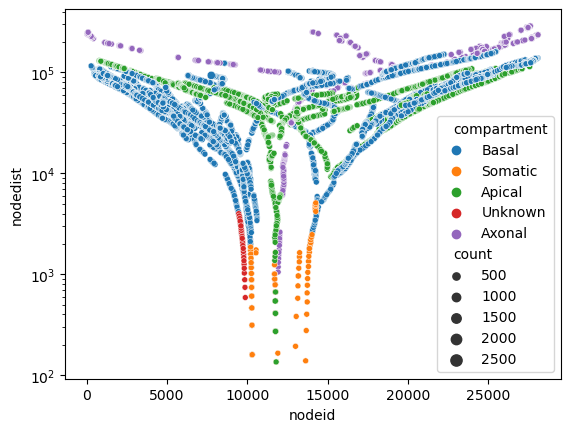

In [25]:
indx = 68
querydf = node_metrics_merge[node_metrics_merge['cellid'] == cellid_list[indx]]
mitoid_list = querydf.mitoid.unique()

sns.scatterplot(querydf, x='nodeid', y='nodedist', hue='compartment', size='count', alpha=1, legend=True) 
plt.yscale('log')

In [26]:
cellids = cellid_str_list
range(len(cellids))

range(0, 363)

# Nodeid vs nodedist example plot

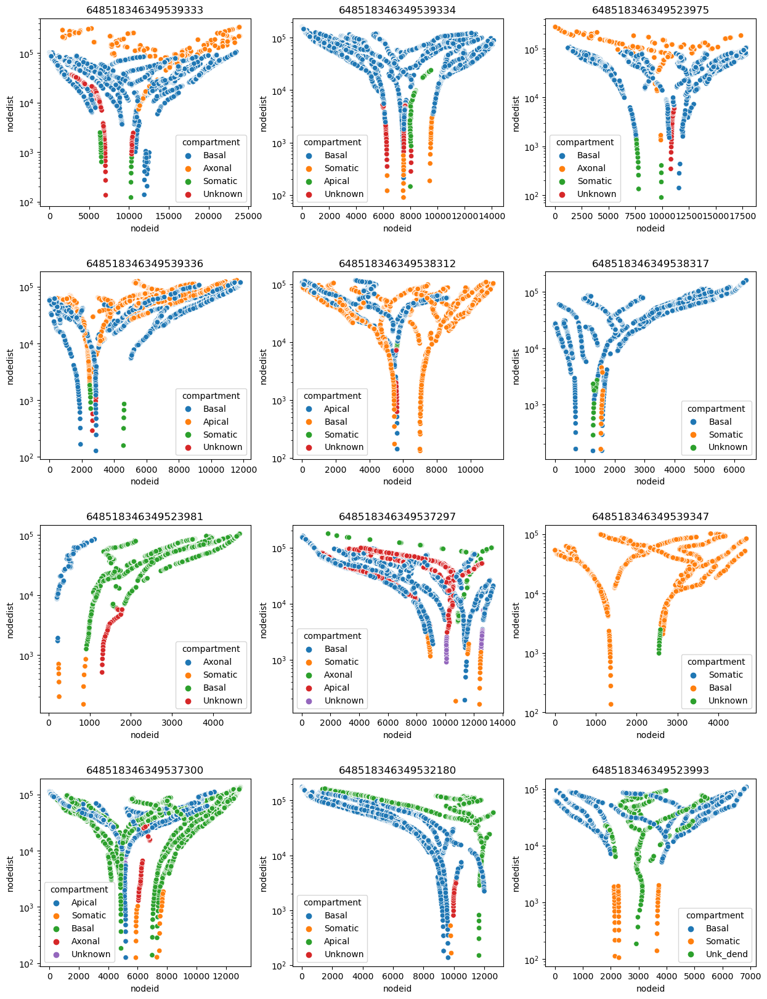

In [27]:
start_time = time.time()

cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i])


plt.savefig('smallmultiples_dpi100.png', dpi=100)
plt.show()

In [28]:
elapsed_time = time.time() - start_time
print(f"Elapsed time: {elapsed_time:.3f} seconds")

Elapsed time: 10.949 seconds


# Print and save page 1 of nodeplots

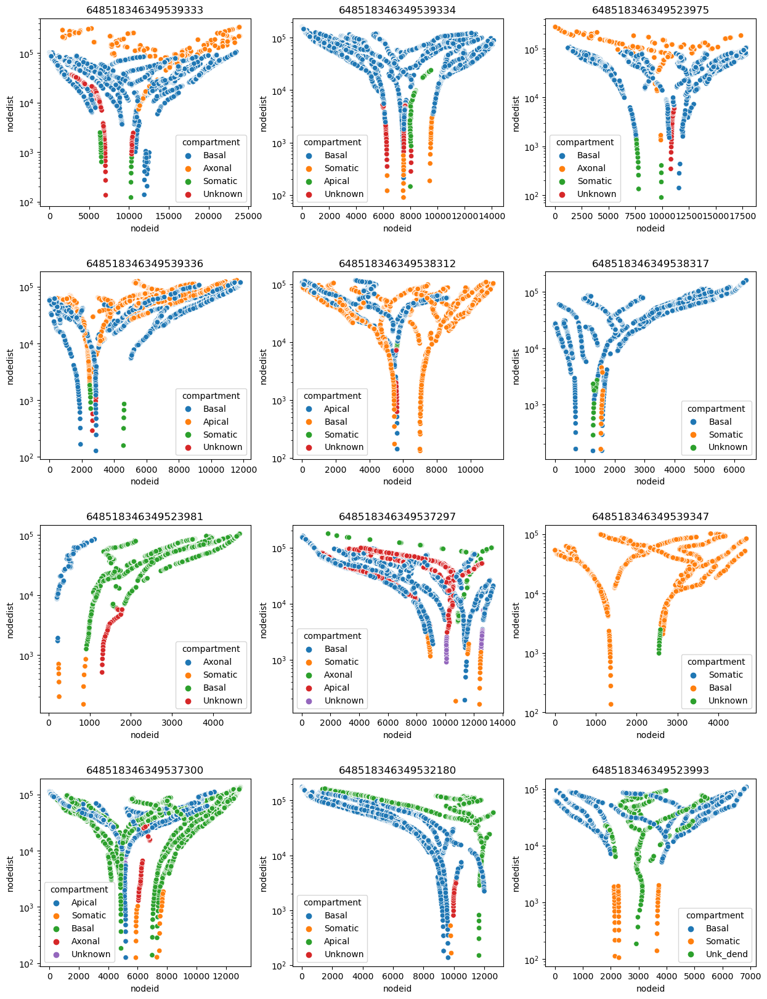

In [29]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i])


plt.savefig('nodeplots/nodeplot_page01.png', dpi=100)
plt.show()

# Print and save page 2 of nodeplots

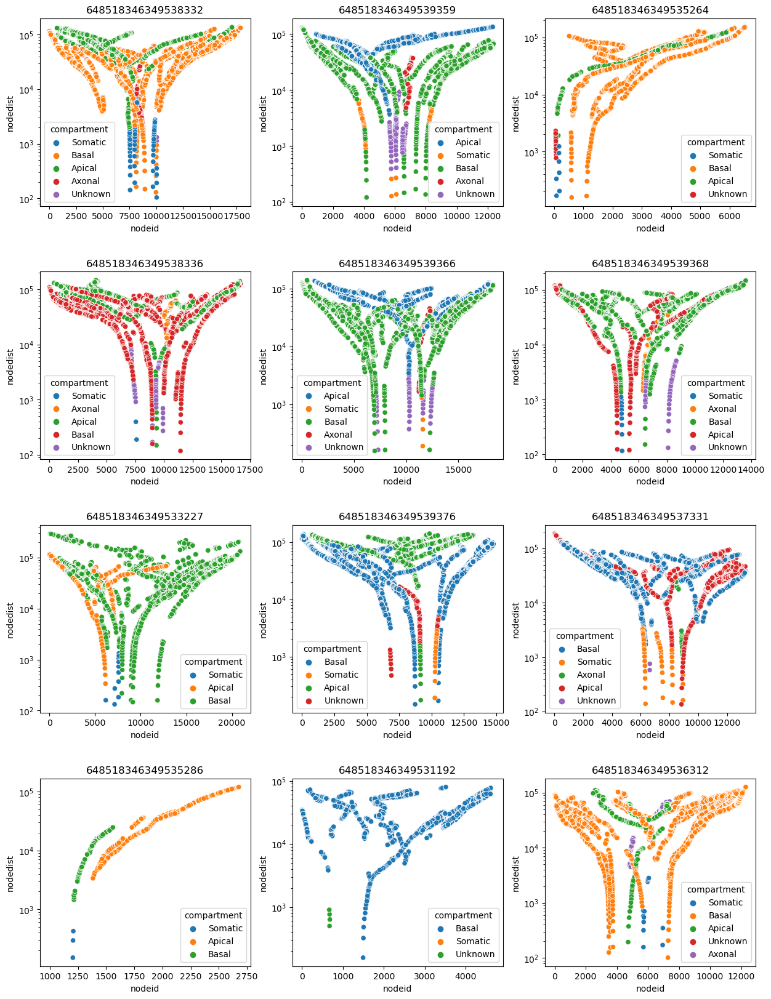

In [30]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+12]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+12])


plt.savefig('nodeplots/nodeplot_page02.png', dpi=100)
plt.show()

# Print and save page 3 of nodeplots

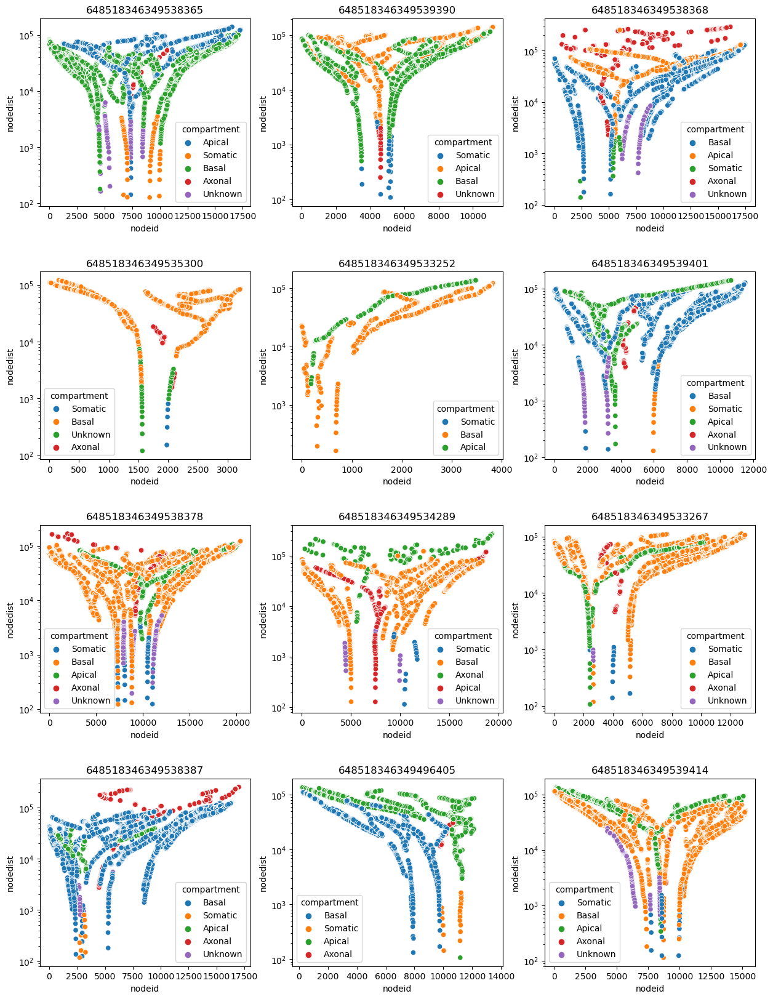

In [31]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+24]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+24])


plt.savefig('nodeplots/nodeplot_page03.png', dpi=100)
plt.show()

# Print and save page 4 of nodeplots

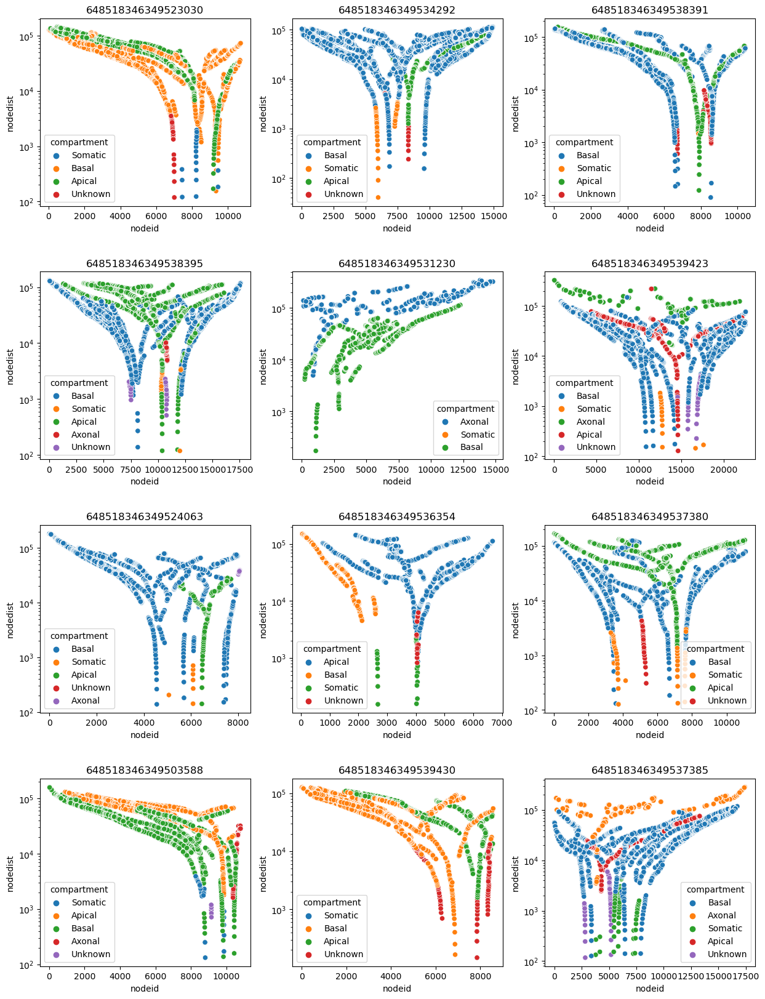

In [32]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+36]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+36])


plt.savefig('nodeplots/nodeplot_page04.png', dpi=100)
plt.show()

# Print and save page 5 of nodeplots

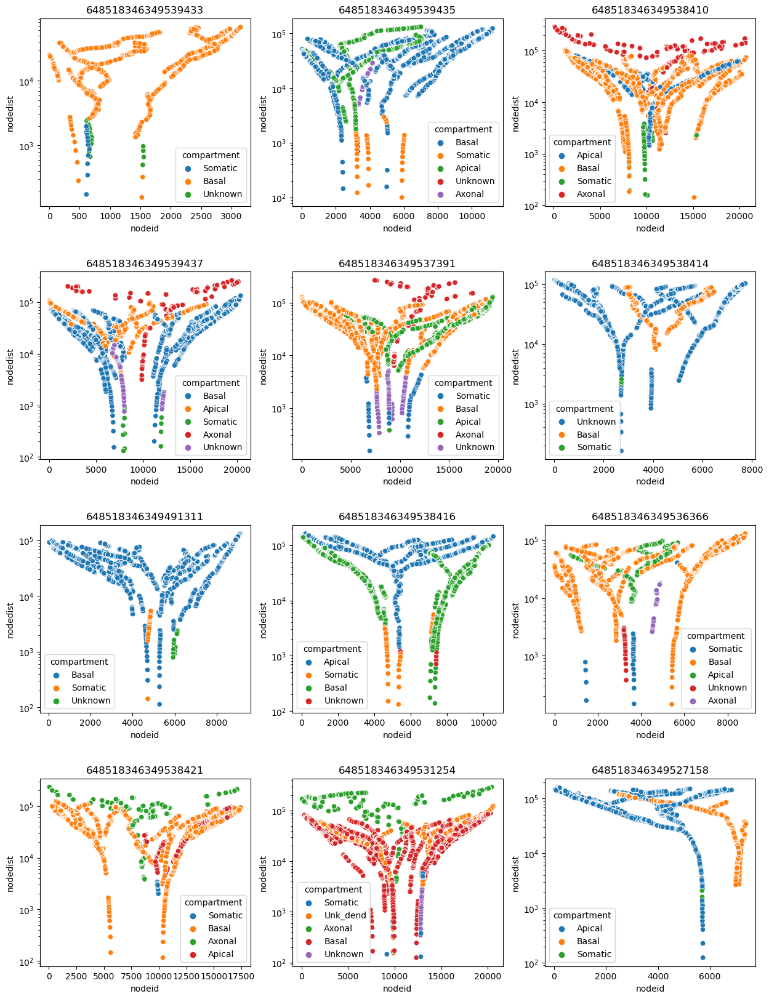

In [33]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+48]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+48])


plt.savefig('nodeplots/nodeplot_page05.png', dpi=100)
plt.show()

# Print and save page 6 of nodeplots

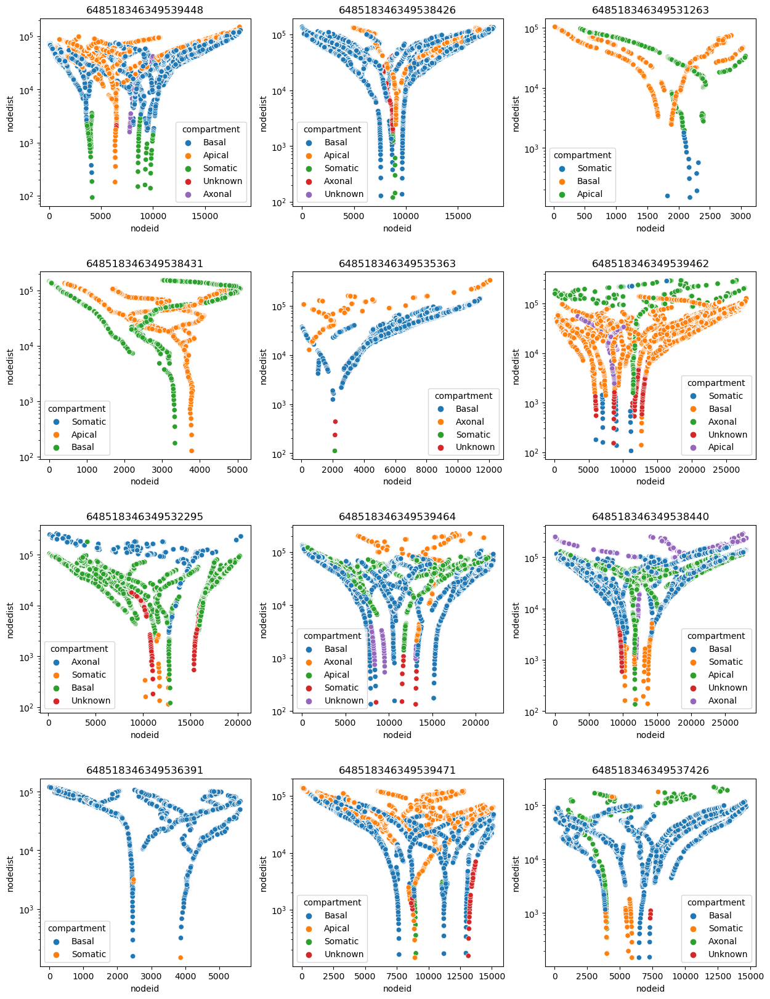

In [34]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+60]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+60])


plt.savefig('nodeplots/nodeplot_page06.png', dpi=100)
plt.show()

# Print and save page 7 of nodeplots

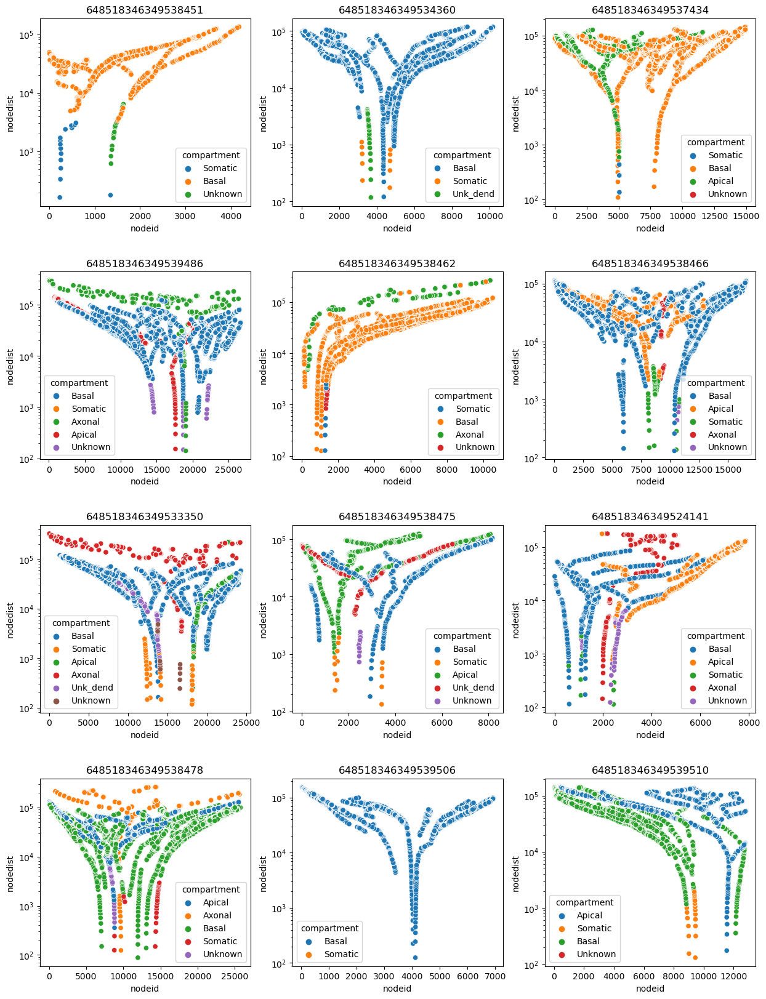

In [35]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+72]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+72])


plt.savefig('nodeplots/nodeplot_page07.png', dpi=100)
plt.show()

# Print and save page 8 of nodeplots

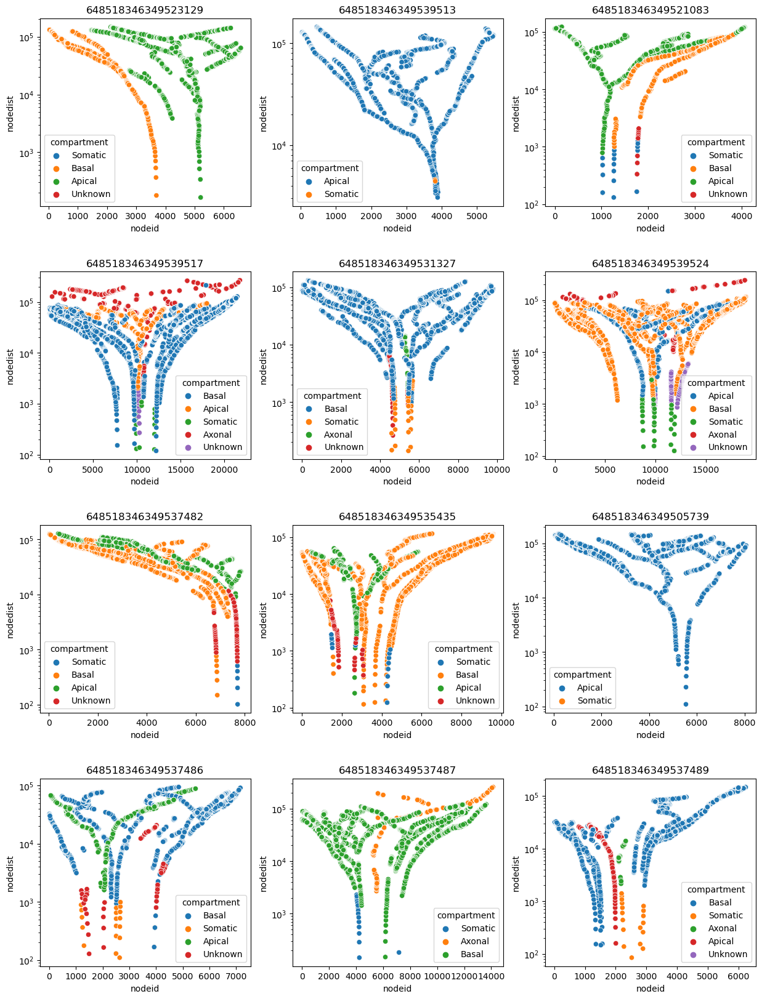

In [36]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+84]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+84])


plt.savefig('nodeplots/nodeplot_page08.png', dpi=100)
plt.show()

# Print and save page 9 of nodeplots

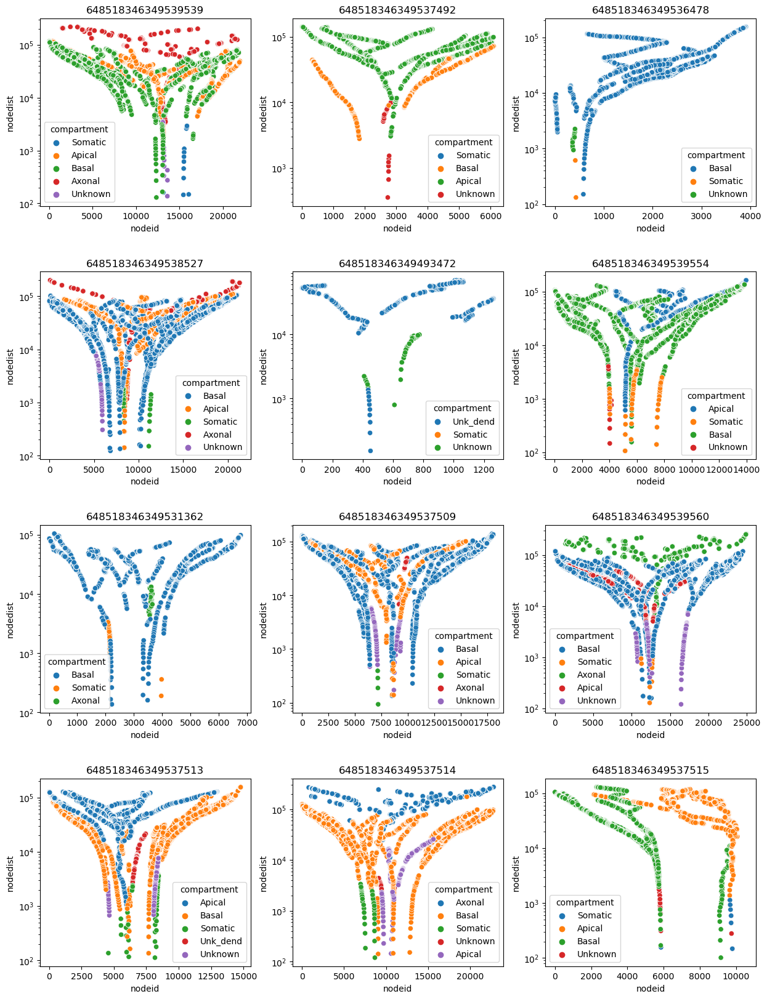

In [37]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+96]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+96])


plt.savefig('nodeplots/nodeplot_page09.png', dpi=100)
plt.show()

# Print and save page 10 of nodeplots

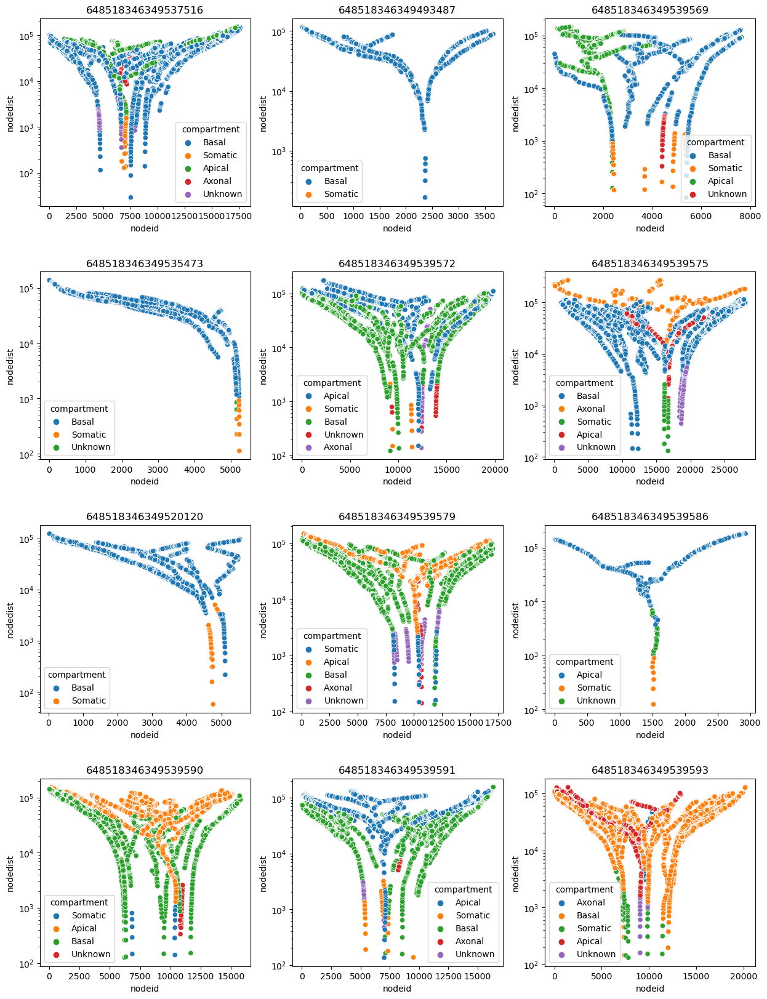

In [38]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+108]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+108])


plt.savefig('nodeplots/nodeplot_page10.png', dpi=100)
plt.show()

# Print and save page 11 of nodeplots

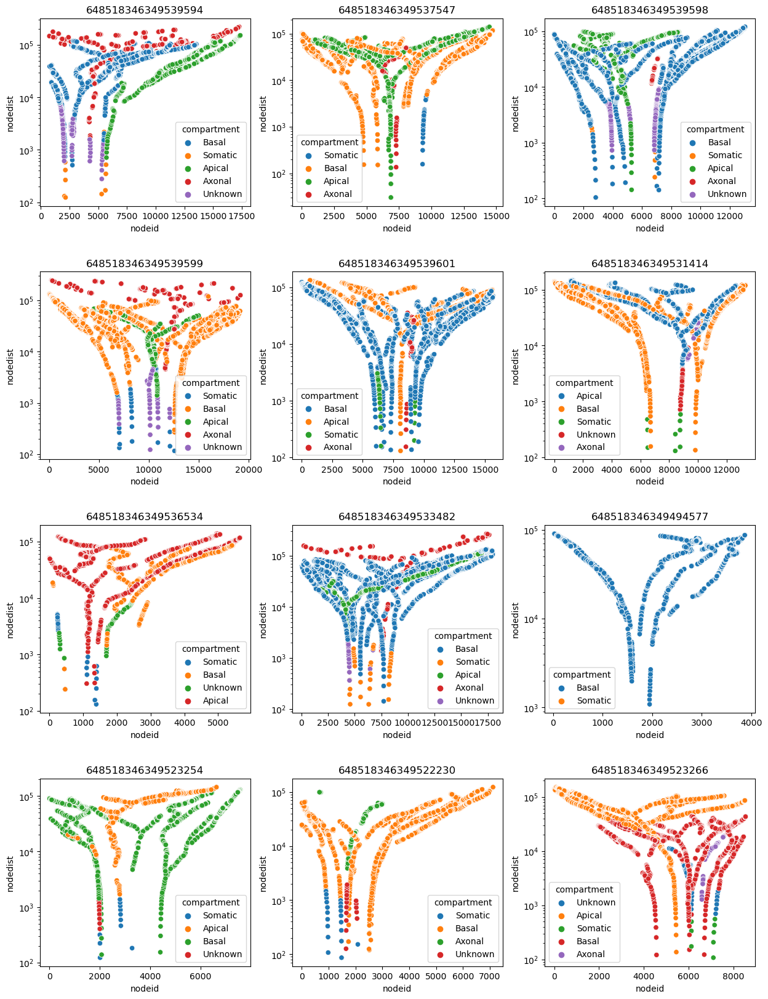

In [39]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+120]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+120])


plt.savefig('nodeplots/nodeplot_page11.png', dpi=100)
plt.show()

# Print and save page 12 of nodeplots

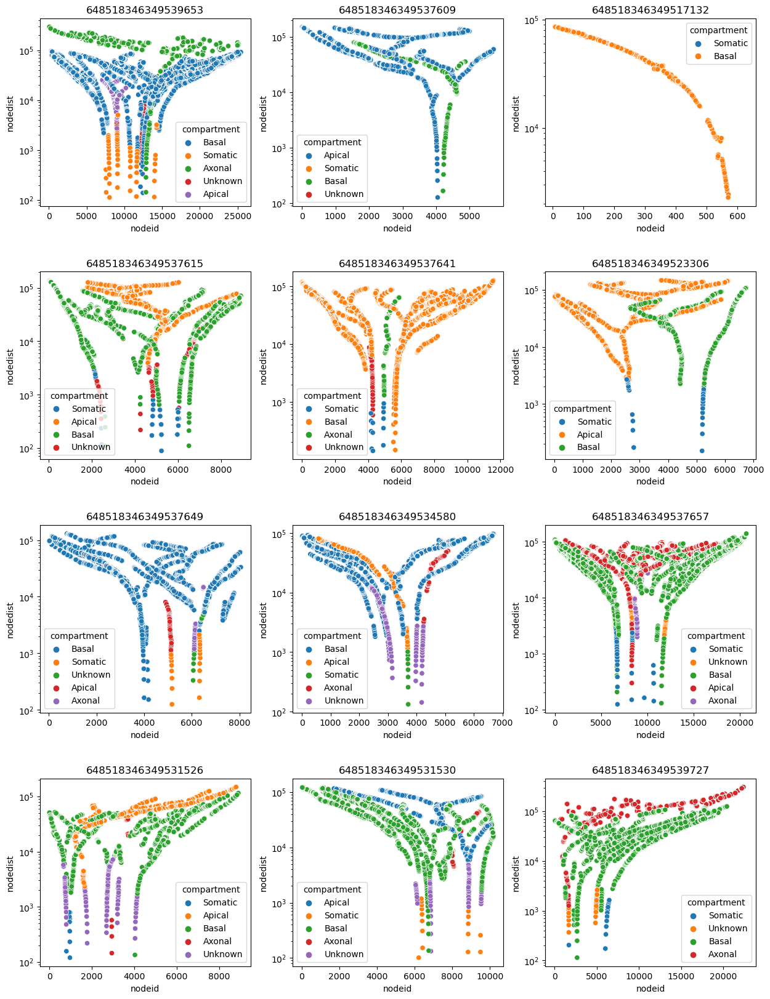

In [40]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+132]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+132])


plt.savefig('nodeplots/nodeplot_page12.png', dpi=100)
plt.show()

# Print and save page 13 of nodeplots

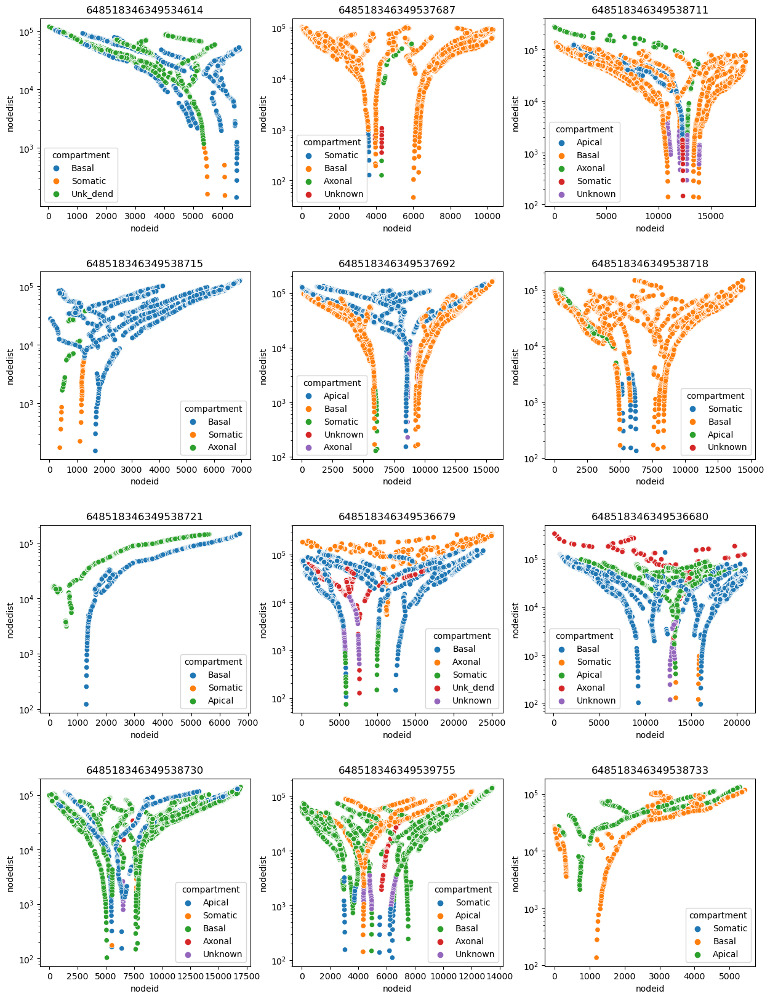

In [41]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+144]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+144])


plt.savefig('nodeplots/nodeplot_page13.png', dpi=100)
plt.show()

# Print and save page 14 of nodeplots

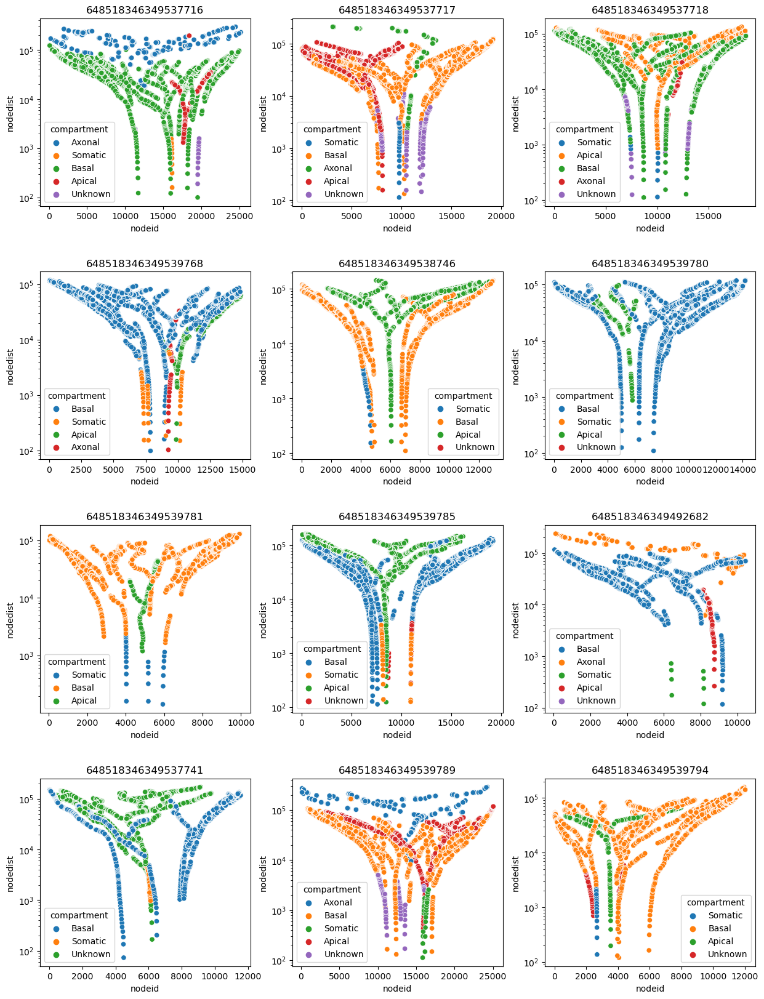

In [42]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+156]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+156])


plt.savefig('nodeplots/nodeplot_page14.png', dpi=100)
plt.show()

# Print and save page 15 of nodeplots

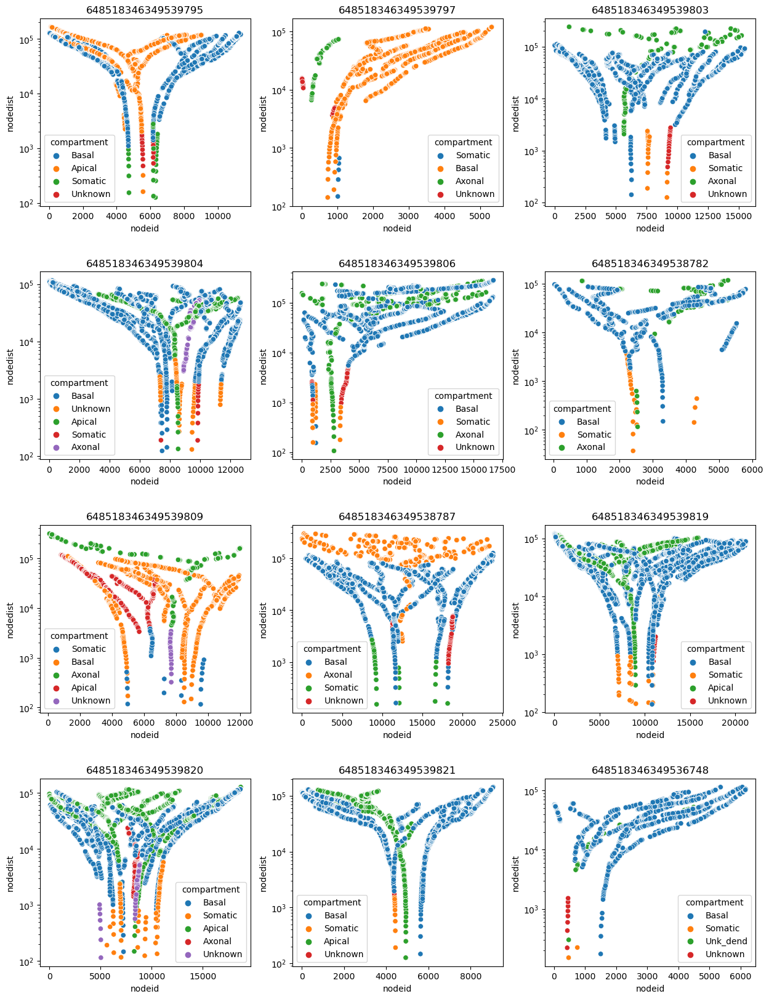

In [43]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+168]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+168])


plt.savefig('nodeplots/nodeplot_page15.png', dpi=100)
plt.show()

# Print and save page 16 of nodeplots

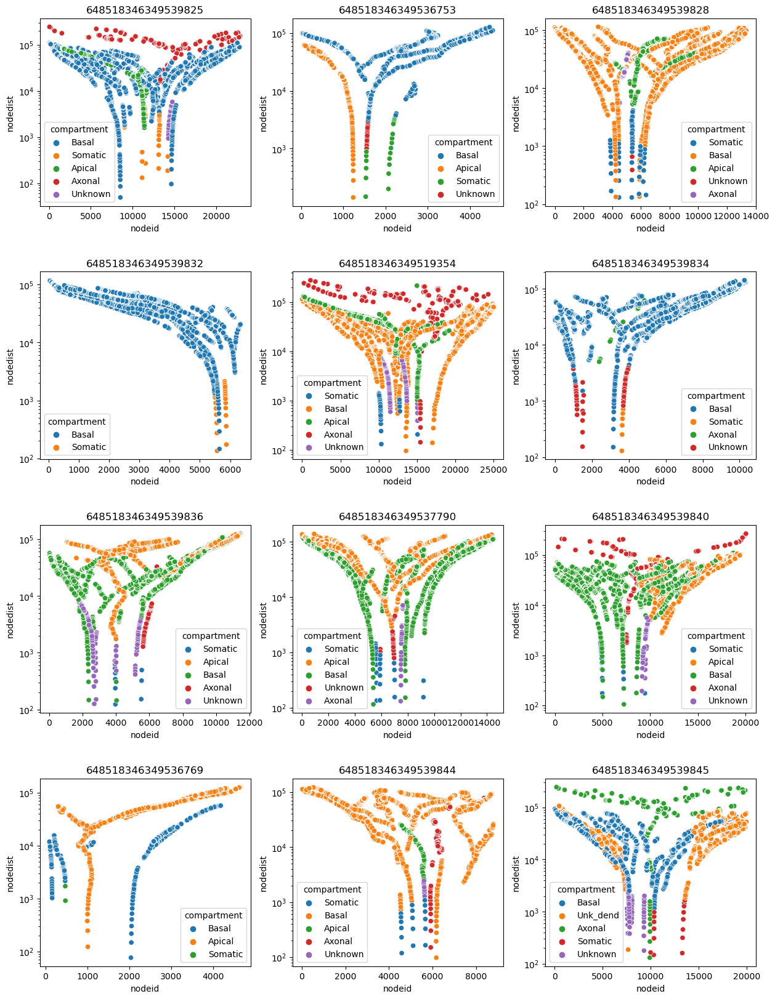

In [44]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+180]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+180])


plt.savefig('nodeplots/nodeplot_page16.png', dpi=100)
plt.show()

# Print and save page 17 of nodeplots

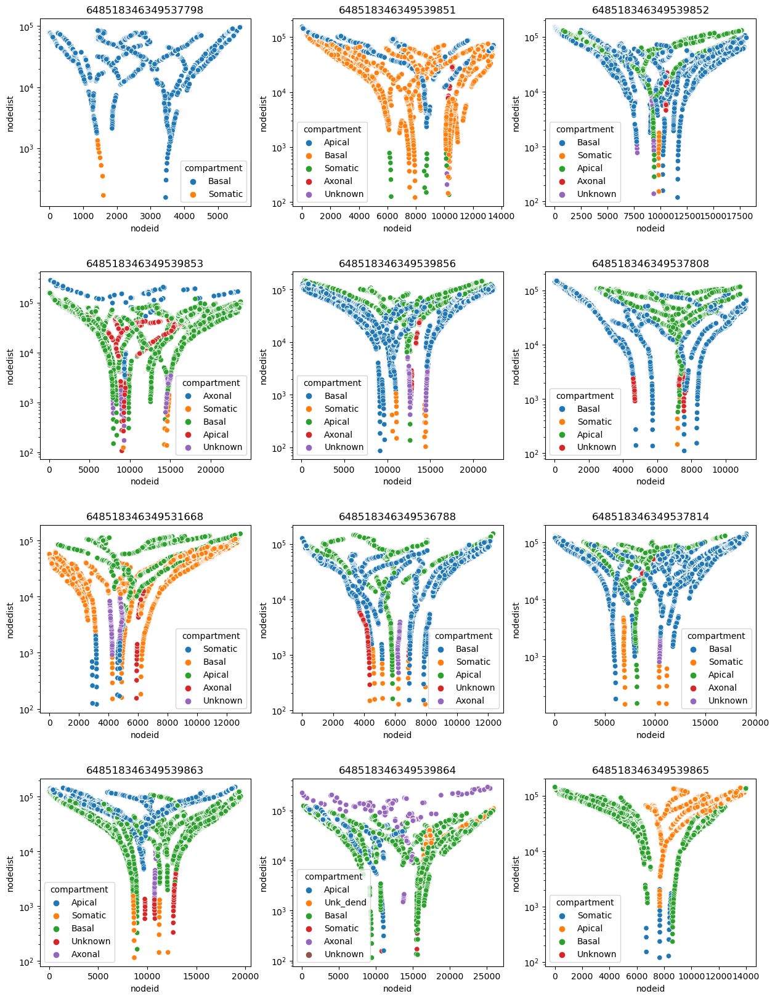

In [45]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+192]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+192])


plt.savefig('nodeplots/nodeplot_page17.png', dpi=100)
plt.show()

# Print and save page 18 of nodeplots

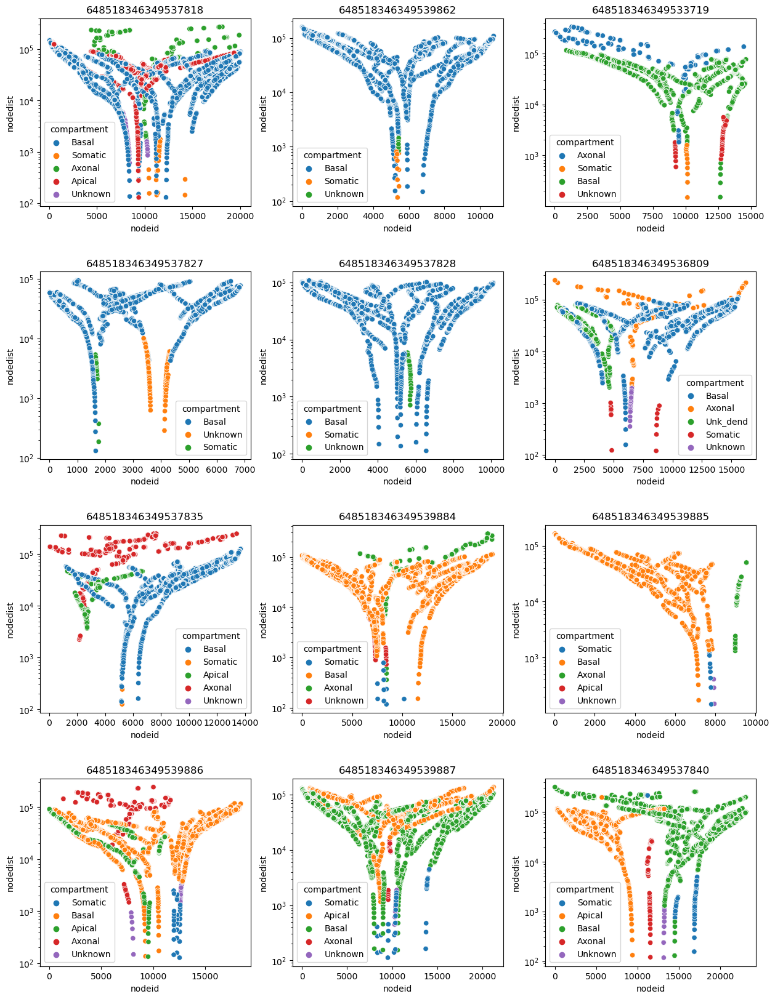

In [46]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+204]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+204])


plt.savefig('nodeplots/nodeplot_page18.png', dpi=100)
plt.show()

# Print and save page 19 of nodeplots

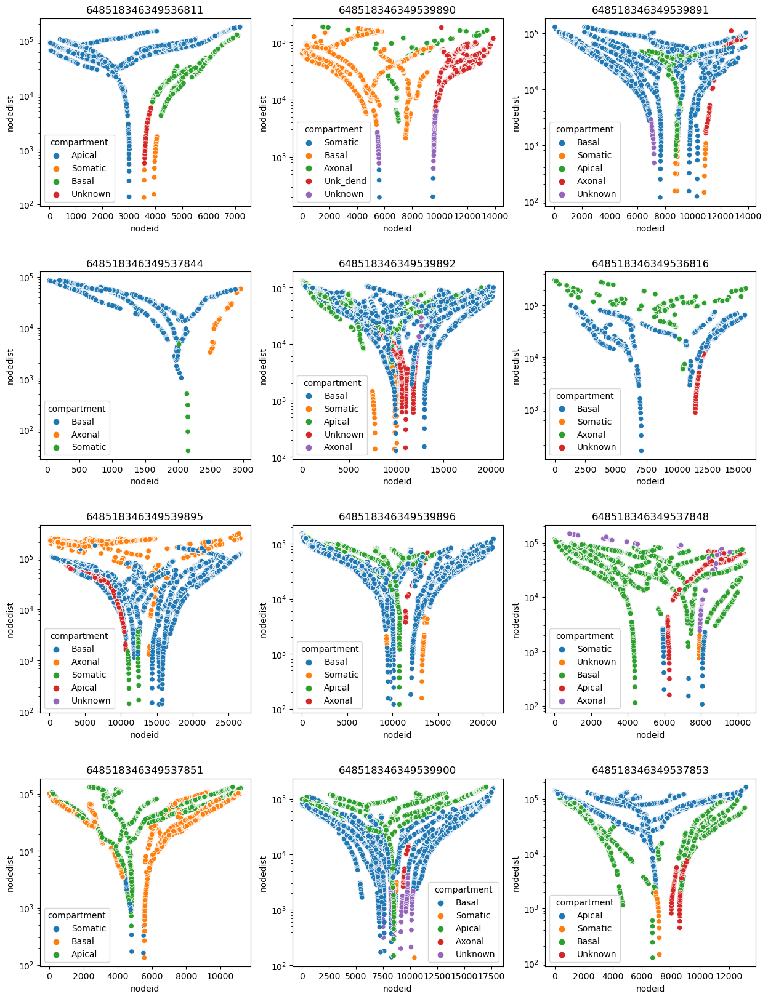

In [47]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+216]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+216])


plt.savefig('nodeplots/nodeplot_page19.png', dpi=100)
plt.show()

# Print and save page 20 of nodeplots

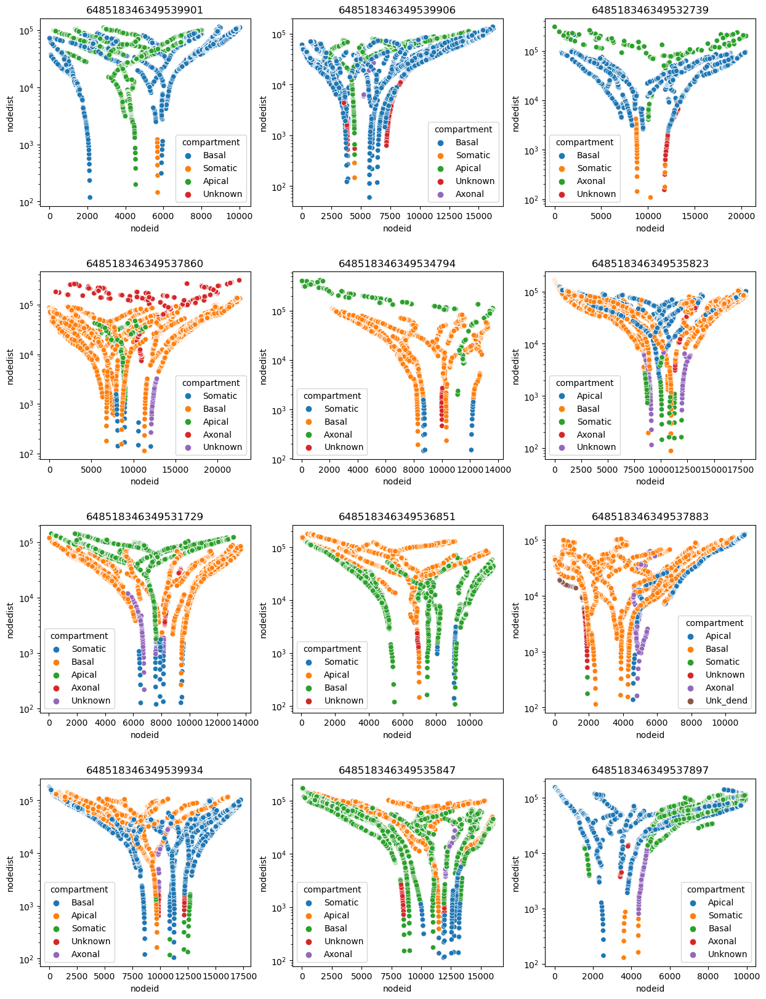

In [48]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+228]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+228])


plt.savefig('nodeplots/nodeplot_page20.png', dpi=100)
plt.show()

# Print and save page 21 of nodeplots

C:\Users\drhan\anaconda3\envs\micronsbinder\lib\site-packages\ipykernel_launcher.py:13: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  del sys.path[0]


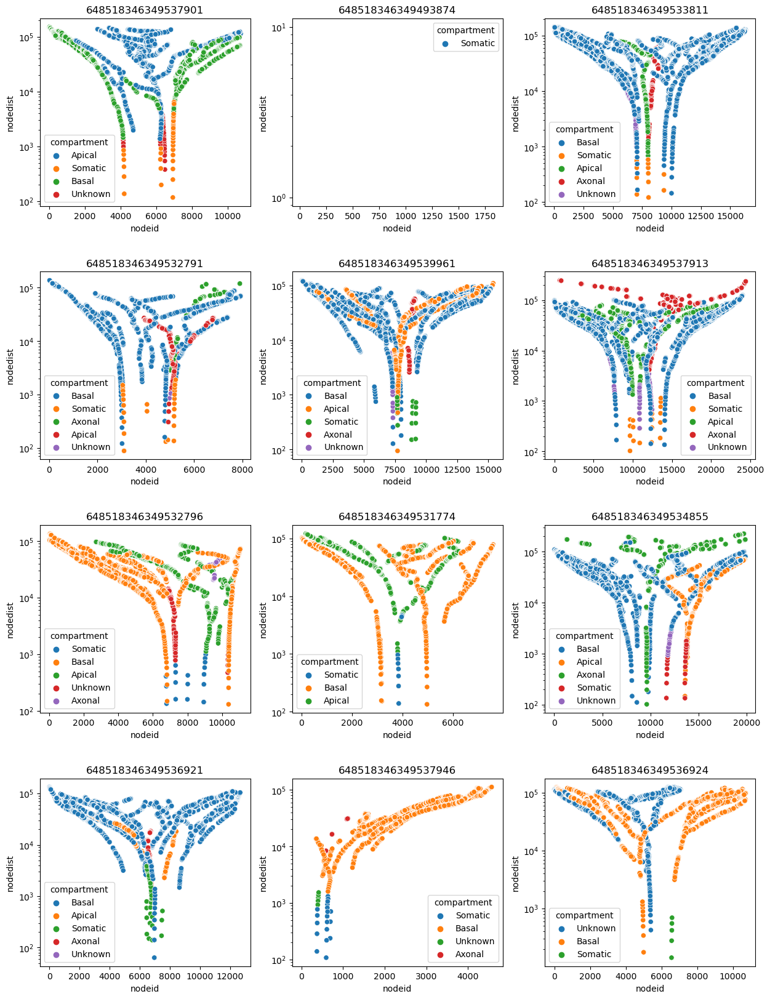

In [49]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+240]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+240])


plt.savefig('nodeplots/nodeplot_page21.png', dpi=100)
plt.show()

# Print and save page 22 of nodeplots

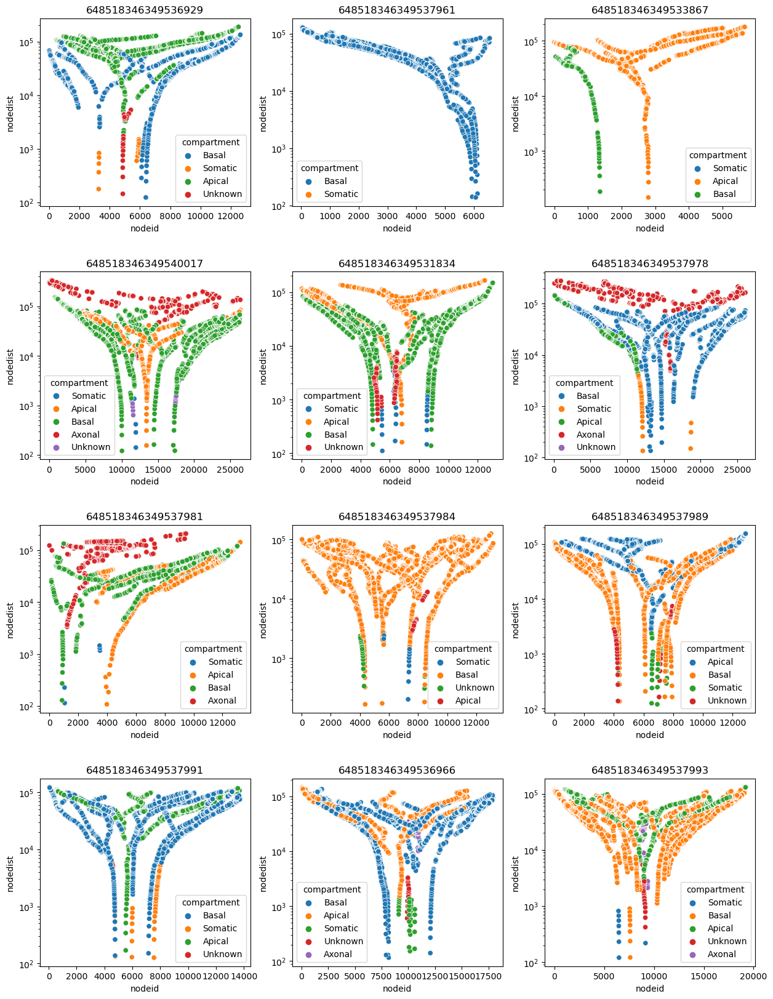

In [50]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+252]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+252])


plt.savefig('nodeplots/nodeplot_page22.png', dpi=100)
plt.show()

# Print and save page 23 of nodeplots

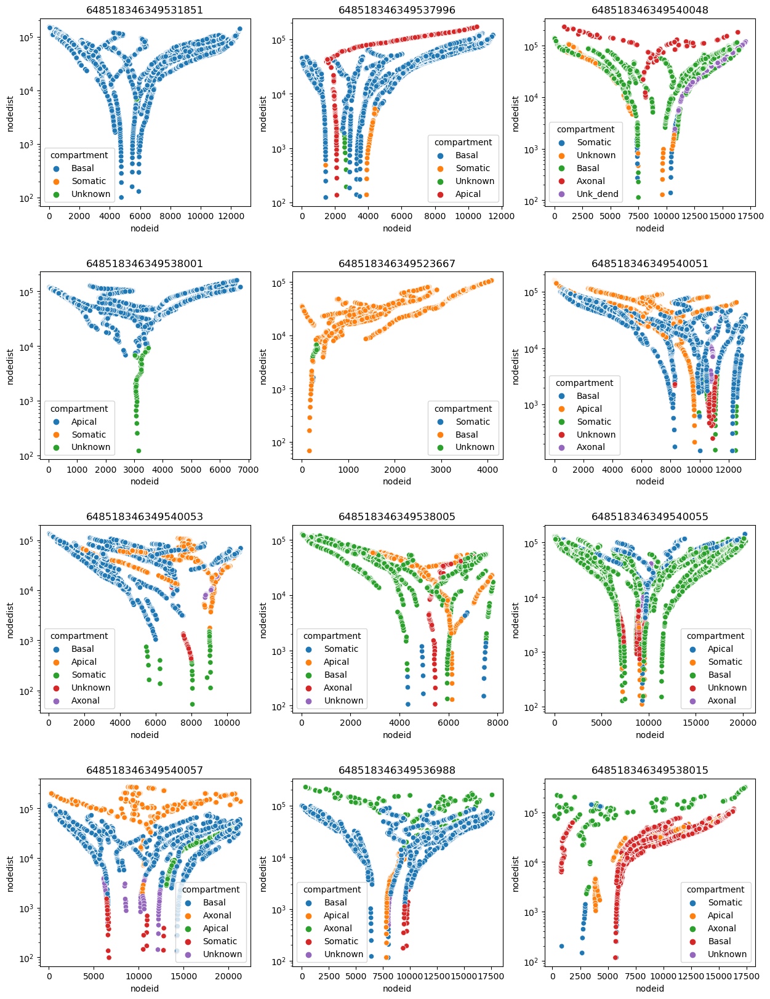

In [51]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+264]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+264])


plt.savefig('nodeplots/nodeplot_page23.png', dpi=100)
plt.show()

# Print and save page 24 of nodeplots

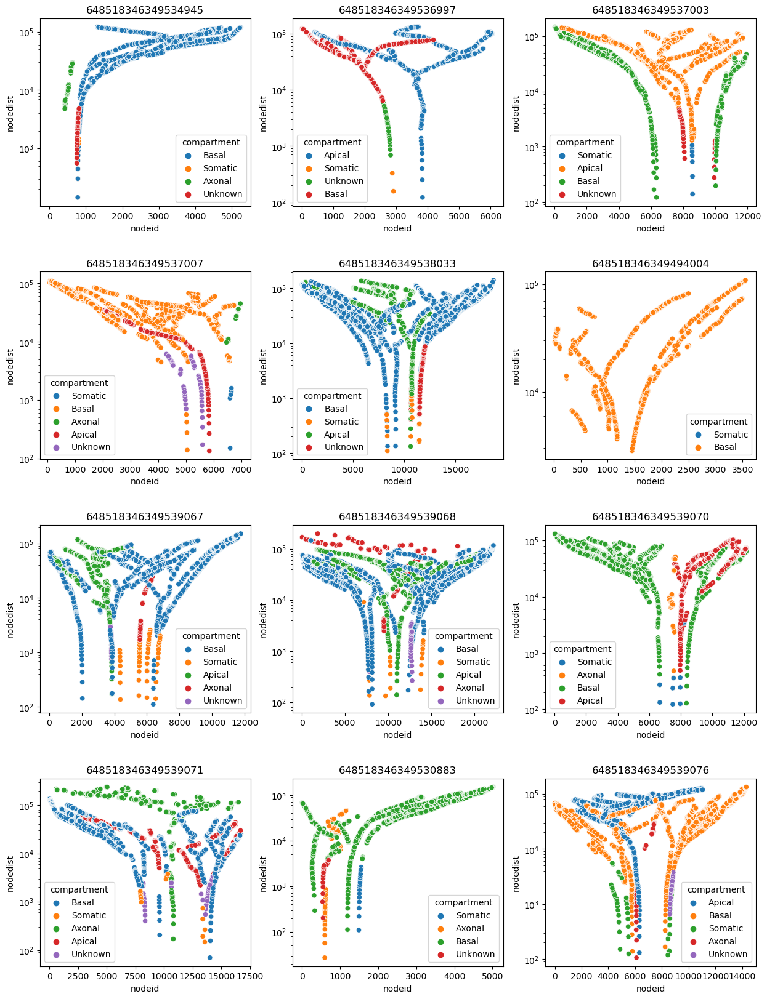

In [52]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+276]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+276])


plt.savefig('nodeplots/nodeplot_page24.png', dpi=100)
plt.show()

# Print and save page 25 of nodeplots

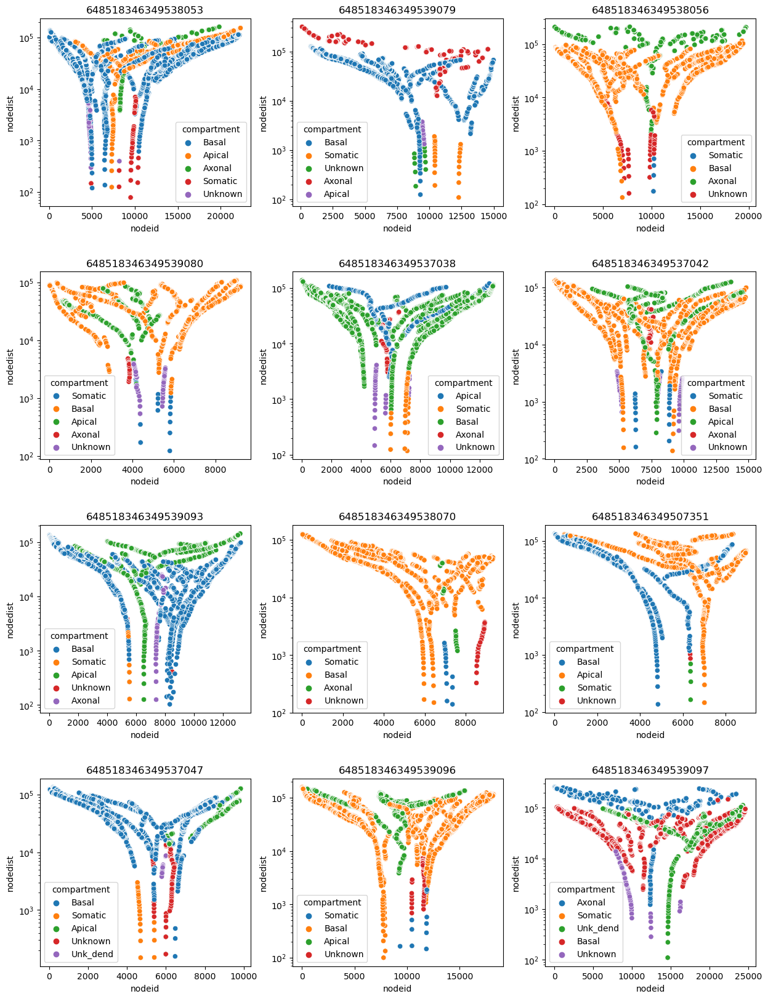

In [53]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+288]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+288])


plt.savefig('nodeplots/nodeplot_page25.png', dpi=100)
plt.show()

# Print and save page 26 of nodeplots

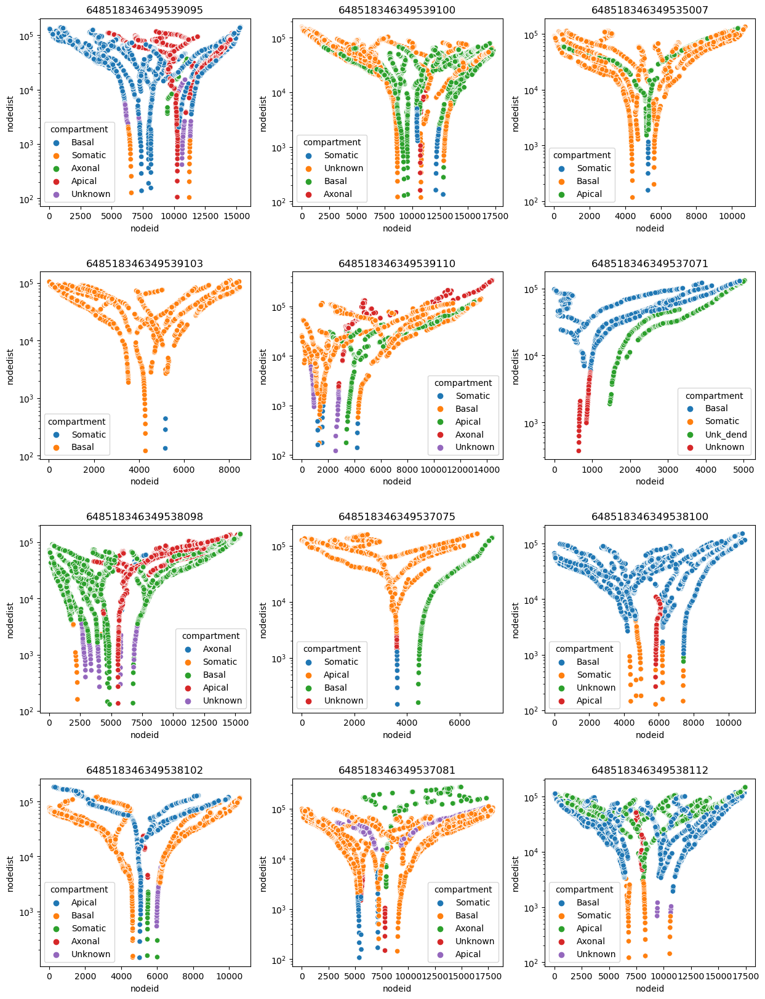

In [54]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+300]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+300])


plt.savefig('nodeplots/nodeplot_page26.png', dpi=100)
plt.show()

# Print and save page 27 of nodeplots

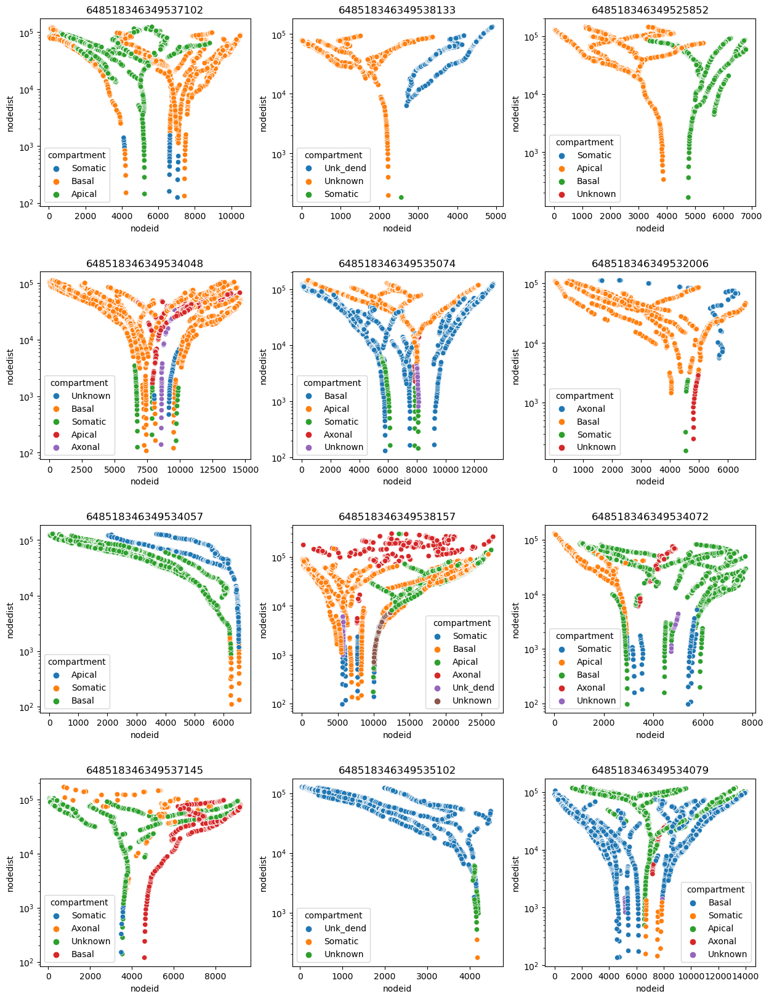

In [55]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+312]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+312])


plt.savefig('nodeplots/nodeplot_page27.png', dpi=100)
plt.show()

# Print and save page 28 of nodeplots

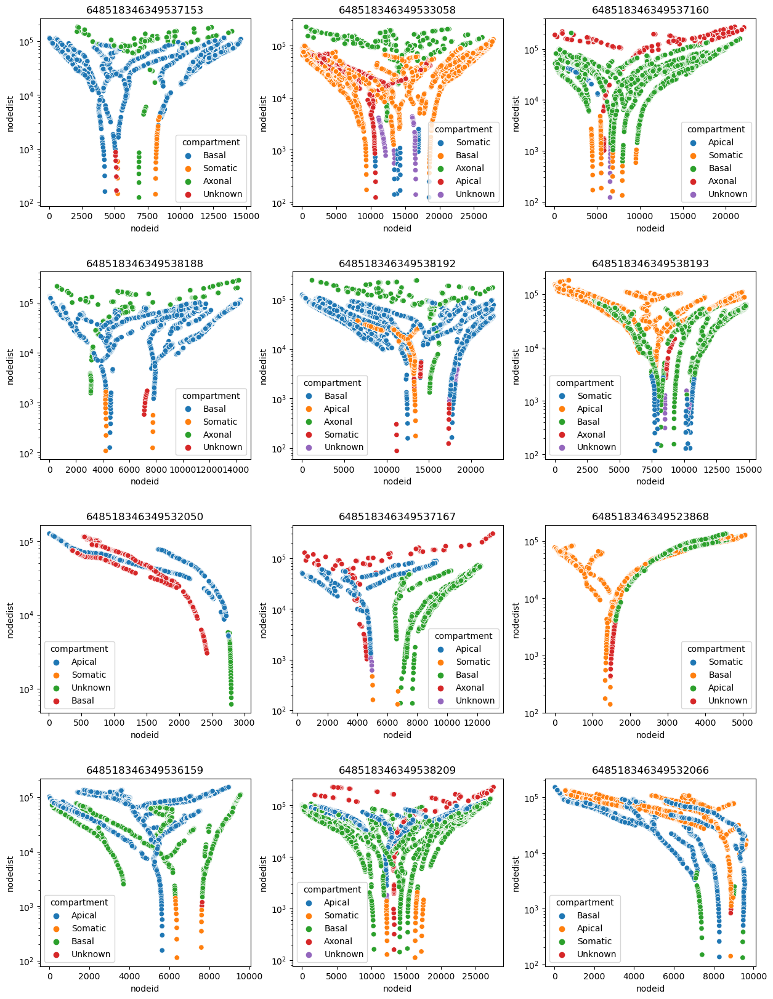

In [56]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+324]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+324])


plt.savefig('nodeplots/nodeplot_page28.png', dpi=100)
plt.show()

# Print and save page 29 of nodeplots

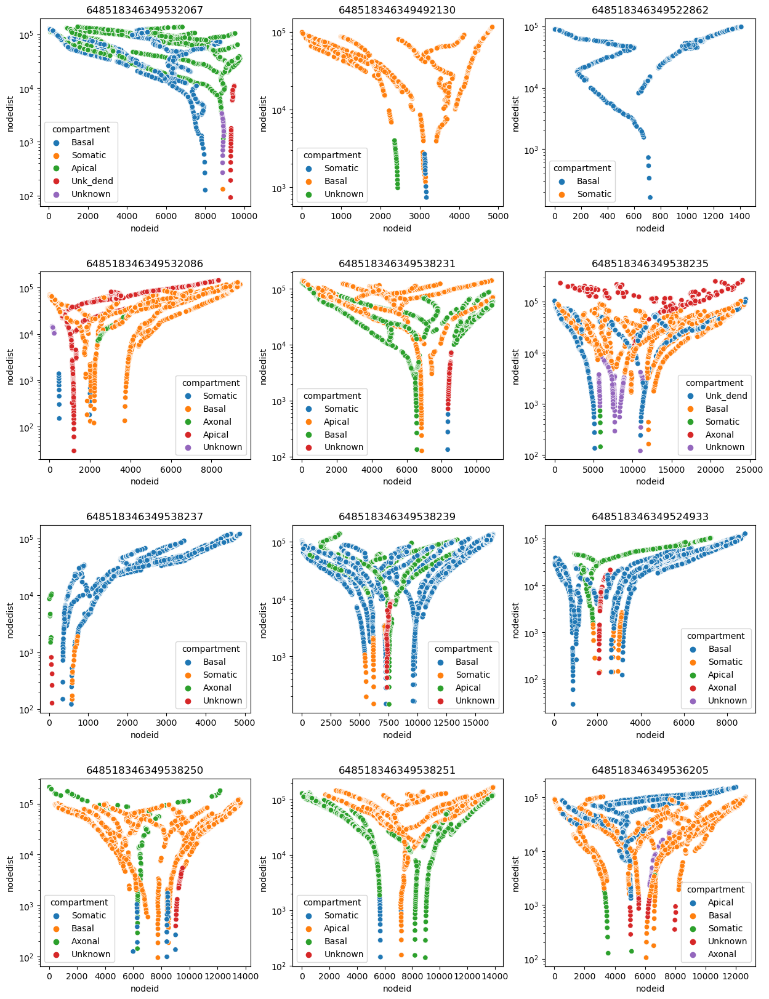

In [57]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+336]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+336])


plt.savefig('nodeplots/nodeplot_page29.png', dpi=100)
plt.show()

# Print and save page 30 of nodeplots

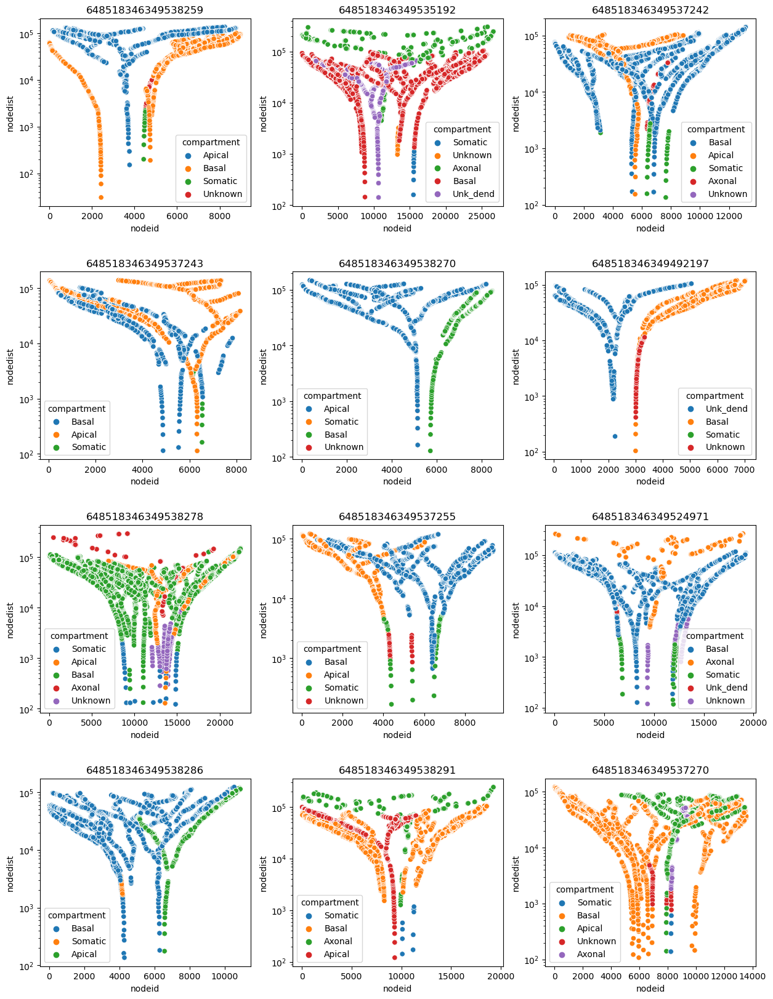

In [58]:
cellids = cellid_str_list
rows = 4
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+348]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+348])


plt.savefig('nodeplots/nodeplot_page30.png', dpi=100)
plt.show()

# Print and save page 31 of nodeplots (partial page)

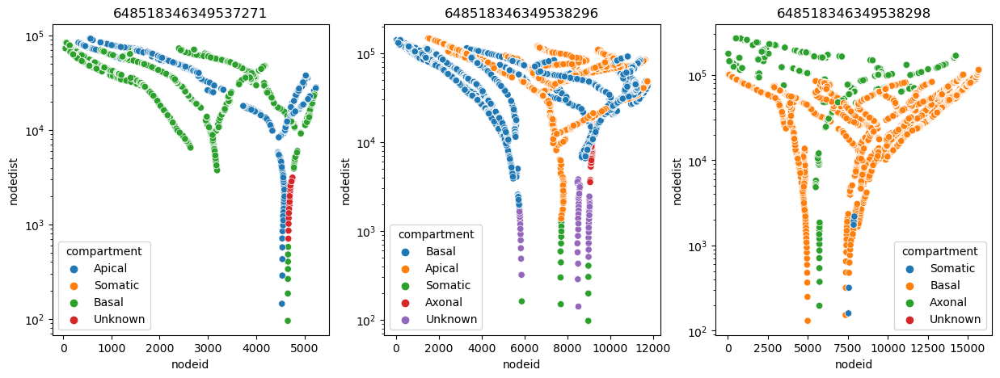

In [59]:
cellids = cellid_str_list
rows = 1
cols = 3
width = 15
height = (width*(rows/cols))

fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(width, height))
plt.subplots_adjust(hspace=0.35)
#fig.suptitle("nodeid vs nodedist by compartment", fontsize=18, y=0.95)
for i in range(rows*cols):
    plt.subplot(rows,cols,i+1)
    ax = sns.scatterplot(node_metrics_merge[node_metrics_merge['cellid_str'] == cellids[i+360]], x='nodeid', y='nodedist', hue='compartment', alpha=1, legend=True) 
    plt.yscale('log')
    ax.set_title(cellids[i+360])


plt.savefig('nodeplots/nodeplot_page31.png', dpi=100)
plt.show()